# Librairies

In [1]:
# basics
import numpy as np
import pandas as pd
import os 
import gc
import math
import csv
import time
import ast
import random
from contextlib import contextmanager
import pprint
import itertools

# preprocessing
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# model selection / metrics
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import make_scorer
from sklearn.metrics import RocCurveDisplay

# model
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
import lightgbm as lgb

# dataviz
import matplotlib.pyplot as plt
import seaborn as sns

# ML Flow
import mlflow
from mlflow.models import infer_signature
import joblib

# SHAP
import shap
shap.initjs()

# warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Preprocessing Data : Functions

## Encoding

In [2]:
def encodeur(X) : 
    print("Tailles des données avant encodage des variables catégorielles :", X.shape)

    # copy numerical features from data
    X_enc = X.select_dtypes(include=np.number) 
    
    # add new features from the encoding of multi_class features : one-hot encoding
    multi_class_cols = [col for col in X.select_dtypes(include=[object]) if X[col].nunique() > 2]
    ohe = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
    ohe.fit(X[multi_class_cols])
    df_multi = pd.DataFrame(ohe.transform(X[multi_class_cols]), columns = ohe.get_feature_names_out(), index=X.index)
    X_enc = pd.concat([X_enc, df_multi], axis=1) 
    
    # add new features from the encoding of binary_class features : label encoding
    bi_class_cols = [col for col in X.select_dtypes(include=[object]) if X[col].nunique() <= 2]
    oe = OrdinalEncoder()
    oe.fit(X[bi_class_cols])
    df_binary = pd.DataFrame(oe.transform(X[bi_class_cols]), columns = oe.feature_names_in_, index=X.index)
    X_enc = pd.concat([X_enc, df_binary], axis=1) # add multi_class features
  
    print("Tailles des données après encodage des variables catégorielles :", X_enc.shape)
    return X_enc

## Exploring

In [3]:
def explorer(dataframe):
    # Information sur les valeurs nulle
    plt.figure(figsize = (5, 4))
    plt.hist(x = dataframe.isnull().mean(), color = 'navy', bins = 10)
    plt.title('Distribution des colonnes selon leur taux de valeurs nulles', fontsize = 10)
    plt.xlabel('taux de valeurs nulles', fontsize = 9)
    plt.ylabel('nb de colonnes', fontsize = 9)
    plt.grid(visible=True)
    plt.show()

    # Information sur les types de données
    type_counts = dataframe.dtypes.value_counts()
    fig, ax = plt.subplots(figsize=(5, 2))
    bars = ax.barh(y = type_counts.index.astype(str), width = type_counts.values, height = 0.5, color = 'navy')
    ax.bar_label(bars, fontsize = 9)
    ax.get_xaxis().set_visible(False)
    plt.yticks(fontsize = 9)
    plt.title('Nb de colonnes par type de données', fontsize = 10)
    plt.show()
    
    # Information sur les variables catégorielles
    class_counts = dataframe.select_dtypes(include=[object]).nunique().value_counts()
    plt.figure(figsize = (5, 4))
    plt.bar(x = class_counts.index, height=class_counts.values, color = 'navy')
    plt.title('Distribution des colonnes catégorielles selon leur nombre de classes', fontsize = 10)
    plt.xlabel('nb de classes', fontsize = 9)
    plt.ylabel('nb de colonnes', fontsize = 9)
    plt.grid(visible=True)
    plt.show()

## Autres fonctions

In [4]:
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - Traité en {:.0f}s".format(title, time.time() - t0))

In [5]:
def shape_printer(title, df):
    print("{} - Tailles des données chargées : {}".format(title, df.shape))

In [6]:
def aligner(X, Y):
    # Aligne les colonnes de X sur celles de Y : renvoit une version de X avec des colonnes ajoutées/supprimées.
    X_aligned = X.copy()
    
    # colonnes en moins
    missing_in_X = [feat for feat in Y if feat not in X]
    added_columns = pd.DataFrame(np.zeros((X.shape[0], len(missing_in_X))), columns = missing_in_X, index=X.index)
    X_aligned = pd.concat([X_aligned, added_columns], axis=1)

    # colonnes en trop
    missing_in_Y = [feat for feat in X if feat not in Y]
    for feat in missing_in_Y : X_aligned.pop(feat)

    return X_aligned

In [7]:
def sigmoid(x: float) -> float:
    return 1 / (1 + math.exp(-x))

## Loading

In [8]:
path_to_files = "../data/kaggle/"

In [9]:
# List files available
print(os.listdir(path_to_files))

['application_test.csv', 'application_train.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'sample_submission.csv']


##### application_train and test.csv (main files)

In [10]:
def main_file(train_or_test='train', num_rows = None):
    df = pd.read_csv(path_to_files + 'application_' + train_or_test + '.csv', nrows = num_rows)
    print("Tailles des données d'origine :", df.shape)

    # Replace the anomalous values with nan
    df['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)
    
    # remove infinity values
    df.replace([np.inf, -np.inf], np.nan, inplace=True)

    # Remove 4 applications with XNA CODE_GENDER (train set)
    df = df[df['CODE_GENDER'] != 'XNA']
    
    # Some simple new features (percentages)
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']

    print("Tailles des données avec features ajoutées :", df.shape)

    return df

Les fonctions ci-dessous ont été reprises du kernel Kaggle "LightGBM with Simple Features" partagé by Aguiar.

In [11]:
# One-hot encoding for categorical columns with get_dummies
def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

### bureau.csv and bureau_balance.sv

In [12]:
# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(df_sk_id, num_rows = None, nan_as_category = True):

    bureau = pd.read_csv(path_to_files+'bureau.csv', nrows = num_rows)
    bb = pd.read_csv(path_to_files+'bureau_balance.csv', nrows = num_rows)

    # Keep only SK_ID provided in the function parameters (used for train/test split)
    bureau = bureau.merge(df_sk_id, how='inner', on='SK_ID_CURR')
    bb = bb.merge(bureau[['SK_ID_BUREAU']], how='inner', on='SK_ID_BUREAU')

    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()

    shape_printer("bureau.csv & bureau_balance.csv", bureau_agg)
    return bureau_agg

### previous_applications.csv

In [13]:
def previous_applications(df_sk_id, num_rows = None, nan_as_category = True):
    prev = pd.read_csv(path_to_files+'previous_application.csv', nrows = num_rows)
    
    # Keep only SK_ID provided in the function parameters (used for train/test split)
    prev = prev.merge(df_sk_id, how='inner', on='SK_ID_CURR')
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    
    #Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    shape_printer("previous_applications.csv", prev_agg)
    return prev_agg

### POS_CASH_balance.csv

In [14]:
# Preprocess POS_CASH_balance.csv
def pos_cash(df_sk_id, num_rows = None, nan_as_category = True):
    pos = pd.read_csv(path_to_files+'POS_CASH_balance.csv', nrows = num_rows)
    
    # Keep only SK_ID provided in the function parameters (used for train/test split)
    pos = pos.merge(df_sk_id, how='inner', on='SK_ID_CURR')
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    shape_printer("POS_CASH_balance.csv", pos_agg)
    return pos_agg

### installments_payments.csv

In [15]:
# Preprocess installments_payments.csv
def installments_payments(df_sk_id, num_rows = None, nan_as_category = True):
    ins = pd.read_csv(path_to_files+'installments_payments.csv', nrows = num_rows)
    
    # Keep only SK_ID provided in the function parameters (used for train/test split)
    ins = ins.merge(df_sk_id, how='inner', on='SK_ID_CURR')
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    shape_printer("installments_payments.csv", ins_agg)
    return ins_agg

### credit_card_balance.csv

In [16]:
# Preprocess credit_card_balance.csv
def credit_card_balance(df_sk_id, num_rows = None, nan_as_category = True):
    cc = pd.read_csv(path_to_files+'credit_card_balance.csv', nrows = num_rows)
    # Keep only SK_ID provided in the function parameters (used for train/test split)
    cc = cc.merge(df_sk_id, how='inner', on='SK_ID_CURR')
    cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()

    # convert boolean columns to numeric values
    boolean_cols = [col for col in cc_agg.select_dtypes(include=[bool])]
    for c in boolean_cols : cc_agg[c] = cc_agg[c].astype(int)
    
    del cc
    gc.collect()
    shape_printer("credit_card_balance.csv", cc_agg)
    return cc_agg

### All secondary files

In [17]:
def add_variables(X):
    print("Tailles des données avant enrichissement :", X.shape)
    print("------------------------------------------")
    
    sk_id = X[['SK_ID_CURR']]
    with timer("bureau.csv & bureau_balance.csv"):
        bureau = bureau_and_balance(sk_id)
        X = X.join(bureau, how='left', on='SK_ID_CURR')
    
    with timer("previous_applications"):
        previous = previous_applications(sk_id)
        X = X.join(previous, how='left', on='SK_ID_CURR')
    
    with timer("POS_CASH_balance.csv"):
        pos = pos_cash(sk_id)
        X = X.join(pos, how='left', on='SK_ID_CURR')
    
    with timer("installments_payments.csv"):
        installments = installments_payments(sk_id)
        X = X.join(installments, how='left', on='SK_ID_CURR')
    
    with timer("credit_card_balance.csv"):
        credit = credit_card_balance(sk_id)
        X = X.join(credit, how='left', on='SK_ID_CURR')
    
    # remove infinity values
    X.replace([np.inf, -np.inf], np.nan, inplace=True)

    print("------------------------------------------")
    print("Tailles des données après enrichissement :", X.shape)

    return X

# Preprocessing Data : Assembling

## Load main file (application.csv)

In [18]:
nombre_de_lignes =  50000 # None # 100000
app_kaggle_train = main_file('train', nombre_de_lignes)

Tailles des données d'origine : (50000, 122)
Tailles des données avec features ajoutées : (49998, 127)


In [19]:
app_kaggle_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,ANNUITY_INCOME_PERC,PAYMENT_RATE
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0.0,0.0,0.0,0.0,1.0,0.067329,0.498036,202500.0,0.121978,0.060749
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0.0,0.0,0.0,0.0,0.0,0.070862,0.208736,135000.0,0.132217,0.027598
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0.0,0.0,0.0,0.0,0.0,0.011814,0.500000,67500.0,0.100000,0.050000
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,NaN,NaN,NaN,NaN,NaN,0.159905,0.431748,67500.0,0.219900,0.094941
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0.0,0.0,0.0,0.0,0.0,0.152418,0.236842,121500.0,0.179963,0.042623


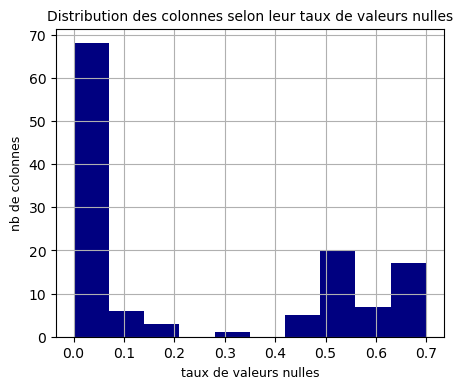

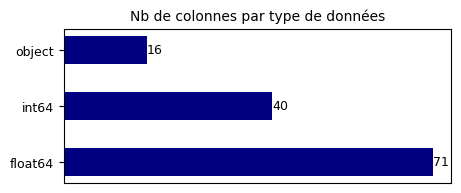

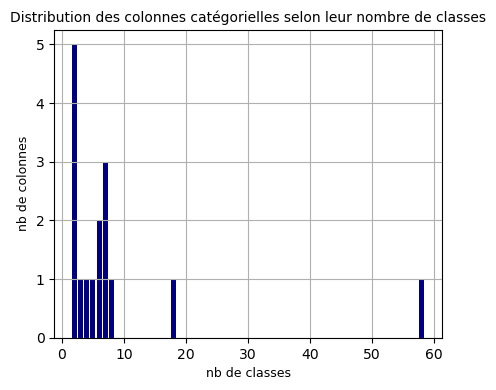

In [20]:
explorer(app_kaggle_train)

## Train/Test Split

In [21]:
X_kaggle_train = app_kaggle_train.drop(columns = 'TARGET')
y_kaggle_train = app_kaggle_train['TARGET']

X_train, X_test, y_train, y_test = train_test_split(X_kaggle_train, y_kaggle_train, test_size = 0.25, random_state = 1209)
print(f"X_train : {X_train.shape} et y_train : {y_train.shape}")
print(f"X_test : {X_test.shape} et y_test : {y_test.shape}")

X_train : (37498, 126) et y_train : (37498,)
X_test : (12500, 126) et y_test : (12500,)


In [22]:
X_train.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,ANNUITY_INCOME_PERC,PAYMENT_RATE
30048,134882,Cash loans,F,N,Y,0,126000.0,1035000.0,30262.5,1035000.0,...,0.0,0.0,0.0,1.0,1.0,0.135446,0.121739,63000.0,0.240179,0.029239
24301,128266,Cash loans,F,N,Y,0,67500.0,283419.0,14526.0,234000.0,...,0.0,0.0,0.0,0.0,0.0,NaN,0.238163,33750.0,0.215200,0.051253
38392,144460,Cash loans,F,N,Y,0,81000.0,106974.0,10710.0,94500.0,...,0.0,0.0,0.0,0.0,1.0,0.172206,0.757193,81000.0,0.132222,0.100118
28852,133526,Cash loans,F,N,N,1,72000.0,545040.0,25537.5,450000.0,...,0.0,0.0,0.0,0.0,2.0,0.028543,0.132100,24000.0,0.354687,0.046854
36165,141882,Cash loans,M,N,Y,0,135000.0,545040.0,26509.5,450000.0,...,0.0,0.0,0.0,0.0,0.0,0.009344,0.247688,67500.0,0.196367,0.048638


In [23]:
y_train.head()

30048    0
24301    0
38392    0
28852    1
36165    0
Name: TARGET, dtype: int64

## Assembling Training Data

In [24]:
# Encodage
X_train_enc = encodeur(X_train)
X_train_enc.head()

Tailles des données avant encodage des variables catégorielles : (37498, 126)
Tailles des données après encodage des variables catégorielles : (37498, 248)


,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,...,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden,WALLSMATERIAL_MODE_nan,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,EMERGENCYSTATE_MODE
30048,134882,0,126000.0,1035000.0,30262.5,1035000.0,0.035792,-8771,-1188.0,-446.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,NaN
24301,128266,0,67500.0,283419.0,14526.0,234000.0,0.018850,-22057,NaN,-3777.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
38392,144460,0,81000.0,106974.0,10710.0,94500.0,0.025164,-12636,-2176.0,-5474.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
28852,133526,1,72000.0,545040.0,25537.5,450000.0,0.009657,-9004,-257.0,-1665.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,NaN
36165,141882,0,135000.0,545040.0,26509.5,450000.0,0.035792,-12628,-118.0,-5952.0,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,NaN


In [25]:
## Add features from secondary files
X_train_enc = add_variables(X_train_enc)
X_train_enc.sort_index(axis=1, inplace=True)

Tailles des données avant enrichissement : (37498, 248)
------------------------------------------
bureau.csv & bureau_balance.csv - Tailles des données chargées : (32132, 113)
bureau.csv & bureau_balance.csv - Traité en 8s
previous_applications.csv - Tailles des données chargées : (35532, 247)
previous_applications - Traité en 6s
POS_CASH_balance.csv - Tailles des données chargées : (35339, 17)
POS_CASH_balance.csv - Traité en 6s
installments_payments.csv - Tailles des données chargées : (35601, 26)
installments_payments.csv - Traité en 9s
credit_card_balance.csv - Tailles des données chargées : (10464, 141)
credit_card_balance.csv - Traité en 6s
------------------------------------------
Tailles des données après enrichissement : (37498, 792)


In [26]:
# Check if data is balanced
y_train.value_counts()

TARGET
0    34452
1     3046
Name: count, dtype: int64

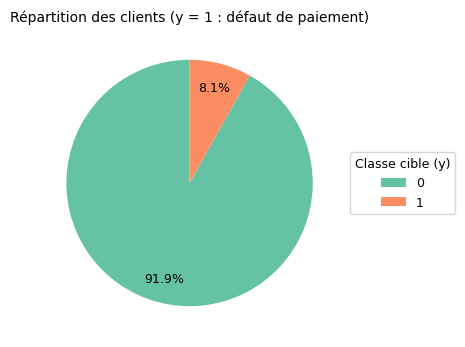

In [27]:
data_pie = y_train.value_counts()

fig, ax =  plt.subplots(figsize=(6, 4))
patches, texts, autotexts = plt.pie(data_pie, autopct='%1.1f%%', pctdistance=0.8, startangle=90, colors=sns.color_palette('Set2'))

plt.title('Répartition des clients (y = 1 : défaut de paiement)', fontsize = 10)
ax.legend(patches, data_pie.index, fontsize = 9, title="Classe cible (y)", title_fontsize  = 9, loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.setp(autotexts, size=9)
plt.show()

## Assembling Test Data

In [28]:
# Encodage
X_test_enc = encodeur(X_test)

Tailles des données avant encodage des variables catégorielles : (12500, 126)
Tailles des données après encodage des variables catégorielles : (12500, 247)


In [29]:
## Add features from secondary files
X_test_enc = add_variables(X_test_enc)

Tailles des données avant enrichissement : (12500, 247)
------------------------------------------
bureau.csv & bureau_balance.csv - Tailles des données chargées : (10717, 110)
bureau.csv & bureau_balance.csv - Traité en 7s
previous_applications.csv - Tailles des données chargées : (11848, 245)
previous_applications - Traité en 5s
POS_CASH_balance.csv - Tailles des données chargées : (11781, 16)
POS_CASH_balance.csv - Traité en 5s
installments_payments.csv - Tailles des données chargées : (11881, 26)
installments_payments.csv - Traité en 8s
credit_card_balance.csv - Tailles des données chargées : (3551, 136)
credit_card_balance.csv - Traité en 5s
------------------------------------------
Tailles des données après enrichissement : (12500, 780)


In [30]:
# Check if data is balanced
y_test.value_counts()

TARGET
0    11520
1      980
Name: count, dtype: int64

In [31]:
# Alignement des colonnes de X_test sur X_train
X_test_enc = aligner(X_test_enc, X_train_enc)
X_test_enc.sort_index(axis=1, inplace=True)
X_test_enc.shape

(12500, 792)

# Modélisation

In [32]:
def bank_loss_func(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    bank_loss = (10*fn + fp) / len(y_true) # un crédit accordé non remboursé est évalué à un montant 10 fois plus élevé qu'un crédit solvable non accordé
    return bank_loss

In [33]:
bank_score = make_scorer(bank_loss_func, greater_is_better=False)

## Déséquilibrage des valeurs cibles

In [34]:
# retrait des NaN
imputer = SimpleImputer(strategy = 'median').set_output(transform="pandas")
X_train_imp = imputer.fit_transform(X_train_enc)

# oversampling customers with y=1 : with smote
smote_sampling_strategy = 0.15
over = SMOTE(sampling_strategy=smote_sampling_strategy, k_neighbors=5, random_state=1209)
X_train_over, y_train_over = over.fit_resample(X_train_imp, y_train)

# undersampling customers with y=0
undersampling_strategy = 0.33
under = RandomUnderSampler(sampling_strategy=undersampling_strategy, random_state=1209)
X_train_bal, y_train_bal = under.fit_resample(X_train_over, y_train_over)

print("Répartition des valeurs 'y' après rééquilibrage :")
print(y_train_bal.value_counts())

Répartition des valeurs 'y' après rééquilibrage :
TARGET
0    15657
1     5167
Name: count, dtype: int64


In [35]:
X_train_enc.columns[400:420]

Index(['LIVE_CITY_NOT_WORK_CITY', 'LIVE_REGION_NOT_WORK_REGION',
       'LIVINGAPARTMENTS_AVG', 'LIVINGAPARTMENTS_MEDI',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_AVG', 'LIVINGAREA_MEDI',
       'LIVINGAREA_MODE', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE_Academic degree',
       'NAME_EDUCATION_TYPE_Higher education',
       'NAME_EDUCATION_TYPE_Incomplete higher',
       'NAME_EDUCATION_TYPE_Lower secondary',
       'NAME_EDUCATION_TYPE_Secondary / secondary special',
       'NAME_FAMILY_STATUS_Civil marriage', 'NAME_FAMILY_STATUS_Married',
       'NAME_FAMILY_STATUS_Separated',
       'NAME_FAMILY_STATUS_Single / not married', 'NAME_FAMILY_STATUS_Widow',
       'NAME_HOUSING_TYPE_Co-op apartment'],
      dtype='object')

In [36]:
X_train_bal.columns[400:420]

Index(['LIVE_CITY_NOT_WORK_CITY', 'LIVE_REGION_NOT_WORK_REGION',
       'LIVINGAPARTMENTS_AVG', 'LIVINGAPARTMENTS_MEDI',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_AVG', 'LIVINGAREA_MEDI',
       'LIVINGAREA_MODE', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE_Academic degree',
       'NAME_EDUCATION_TYPE_Higher education',
       'NAME_EDUCATION_TYPE_Incomplete higher',
       'NAME_EDUCATION_TYPE_Lower secondary',
       'NAME_EDUCATION_TYPE_Secondary / secondary special',
       'NAME_FAMILY_STATUS_Civil marriage', 'NAME_FAMILY_STATUS_Married',
       'NAME_FAMILY_STATUS_Separated',
       'NAME_FAMILY_STATUS_Single / not married', 'NAME_FAMILY_STATUS_Widow',
       'NAME_HOUSING_TYPE_Co-op apartment'],
      dtype='object')

In [37]:
X_train_enc['AMT_ANNUITY'].describe()

count     37497.000000
mean      27076.577526
std       14634.097706
min        2052.000000
25%       16434.000000
50%       24894.000000
75%       34596.000000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

<Axes: >

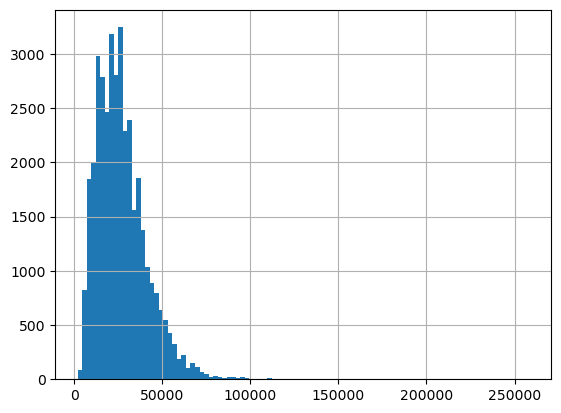

In [38]:
X_train['AMT_ANNUITY'].hist(bins=100)

<Axes: >

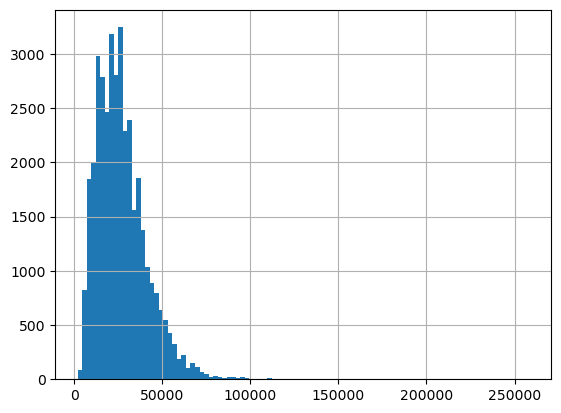

In [39]:
X_train_enc['AMT_ANNUITY'].hist(bins=100)

In [ ]:
X_train_enc['APPROVED_CNT_PAYMENT_MEAN'].hist(bins=100)

## Modèle de base : régression logistique

In [286]:
pipe = Pipeline([
    ('imputer', SimpleImputer(strategy = 'median')),
    ('scaler', StandardScaler()),
    ('clf', LogisticRegression(penalty='l2', class_weight='balanced', C=10, max_iter=1000))]
)

### Entraînement du modèle

#### Optimisation des paramètres

In [287]:
# grille de paramètres
lr_grid = {'clf__C' : np.logspace(-2, 1, 6)} # Inverse of regularization strength -> best = 10
#lr_grid = {'clf__C' : [0.1]}

# initialiser la validation croisée
lr_search = GridSearchCV(pipe, lr_grid, cv=5, scoring=bank_score)

# On entraîne ce modèle sur les données d'entrainement
lr_search.fit(X_train_bal, y_train_bal)

# On extrait la meilleure combinaison de paramètres
res = pd.DataFrame(lr_search.cv_results_)[['param_clf__C', 'mean_test_score', 'std_test_score', 'rank_test_score', 'mean_fit_time']]
res.sort_values('rank_test_score').head(10)

,param_clf__C,mean_test_score,std_test_score,rank_test_score,mean_fit_time
4,2.511886,-0.879458,0.131814,1,6.301188
5,10.0,-0.880466,0.130988,2,7.787727
3,0.630957,-0.881955,0.133309,3,4.915417
2,0.158489,-0.885941,0.128411,4,3.697778
1,0.039811,-0.886037,0.119281,5,2.874889
0,0.01,-0.896410,0.111507,6,2.362945


#### Fit

In [288]:
# Le modèle est entraîné sur les données équilibrées
pipe.set_params(**lr_search.best_params_).fit(X_train_bal, y_train_bal)
#pipe.fit(X_train_bal, y_train_bal)

Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),
                ('scaler', StandardScaler()),
                ('clf',
                 LogisticRegression(C=2.5118864315095797,
                                    class_weight='balanced', max_iter=1000))])

#### Optimisation du seuil

In [40]:
def custom_threshold_func(y_true, y_proba) :
    best_threshold = 0.5
    y_pred = (y_proba > 0.5).astype(int)
    lower_loss = bank_loss_func(y_true, y_pred) 
    for threshold in range(100) :
        y_thresh = (y_proba > (threshold/100)).astype(int)
        loss = bank_loss_func(y_true, y_thresh) 
        #print(f"loss : {loss} / threshold : {threshold}")
        if loss <= lower_loss :
            lower_loss = loss
            best_threshold = threshold
    print('custom threshold : %.02f' % (best_threshold/100))
    return best_threshold/100

In [290]:
# Les prédictions à partir desquelles on va chercher le seuil optimum sont faites à partir des données déséquilibrées
y_train_proba = pipe.predict_proba(X_train_enc)[:, 1]

In [291]:
lr_custom_threshold = custom_threshold_func(y_train, y_train_proba)

custom threshold : 0.54


### Test results

In [41]:
def evaluer(y_true, y_score, custom_threshold, verbose=False) :
    "Retourne des indicateurs de performances du modèle : accuracy, roc_auc, bank_loss à partir des scores et du seuil donné en paramètre"
    
    # Classification basée sur le seuil optimum calculé en entraînement
    y_class = (y_score > custom_threshold).astype(int)
    
    accuracy = round(accuracy_score(y_true, y_class), 2)
    roc_auc = round(roc_auc_score(y_true, y_score), 2)
    bank_loss = bank_loss_func(y_true, y_class)
    
    if verbose==True :
        print(f"accuracy : {accuracy:.2f}\nroc_auc : {roc_auc:.2f}\nbank_loss : {bank_loss}\n")
        print("Matrice de confusion :")
        print(confusion_matrix(y_true, y_class))
    return accuracy, roc_auc, bank_loss

accuracy : 0.75
roc_auc : 0.76
bank_loss : 0.51312

Matrice de confusion :
[[8746 2774]
 [ 364  616]]


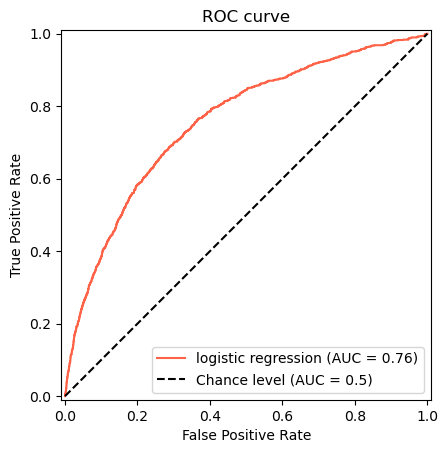

In [293]:
# Calcul des scores de classification
y_test_proba_lr = pipe.predict_proba(X_test_enc)[:, 1]

# Indicateurs de performances
lr_accuracy, lr_roc_auc, lr_bank_loss = evaluer(y_test, y_test_proba_lr, lr_custom_threshold, True)

# Affichage de la courbe ROC
lr_RocCurve = RocCurveDisplay.from_predictions(y_test, y_test_proba_lr, name="logistic regression", color="tomato", plot_chance_level=True,)
lr_RocCurve.ax_.set(xlabel="False Positive Rate", ylabel="True Positive Rate", title="ROC curve")
plt.show()

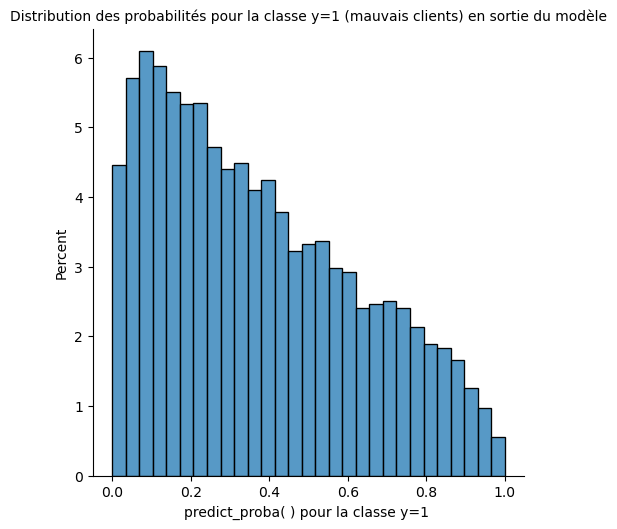

In [294]:
sns.displot(y_test_proba_lr, stat='percent')
plt.title('Distribution des probabilités pour la classe y=1 (mauvais clients) en sortie du modèle', fontsize = 10)
plt.xlabel('predict_proba( ) pour la classe y=1 ', fontsize = 10)
plt.show()

### Log to ML Flow

In [45]:
# In a prompt :
# cd 'C:\Applications\Git\OC-DataScientist-P7\project\mlflow>'
# mlflow ui --port 5050

# Set our tracking server uri for logging
mlflow.set_tracking_uri(uri="http://localhost:5050")

# Create a new MLflow Experiment
#mlflow.delete_experiment(895810586240779389)
experiment_name = "OC-DataScientist-P7"
mlflow.set_experiment(experiment_name)


<Experiment: artifact_location='mlflow-artifacts:/111126380772314288', creation_time=1716273840002, experiment_id='111126380772314288', last_update_time=1716273840002, lifecycle_stage='active', name='OC-DataScientist-P7', tags={}>

In [46]:
# Start an MLflow run
with mlflow.start_run(description="Modèle de base"):
    # Log the hyperparameters
    params = pipe.get_params(deep=False)
    params['custom_threshold_for_classif'] = custom_threshold
    params['smote_sampling_strategy'] = smote_sampling_strategy
    params['undersampling_strategy'] = undersampling_strategy
    mlflow.log_params(params)

    # Log the model metrics (from test results)
    mlflow.log_metrics({"accuracy":accuracy, "roc_auc":roc_auc, "bank_loss":bank_loss})

    # Set a tag that we can use to remind ourselves what this run was for
    mlflow.set_tags({
        "Model type" : "Logistic regression",
        "Nb of lines" : "10k",
        "Rebalancing method" : "Smote + undersampling",
        "Feature selection" : "None"})

    # Infer the model signature
    signature = infer_signature(X_train_bal, pipe.predict(X_train_bal))

    # Log the model
    model_info = mlflow.sklearn.log_model(
        sk_model=pipe,
        artifact_path="Kaggle Kernel with simple features (Aguiar)",
        signature=signature,
        input_example=X_train_bal,
        registered_model_name= experiment_name + "__" + "logistic-regression",
    )

C:\Applications\Anaconda\Lib\site-packages\_distutils_hack\__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")
Successfully registered model 'OC-DataScientist-P7__logistic-regression'.
2024/05/24 13:30:26 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: OC-DataScientist-P7__logistic-regression, version 1
Created version '1' of model 'OC-DataScientist-P7__logistic-regression'.


### Features importance

#### From SHAP

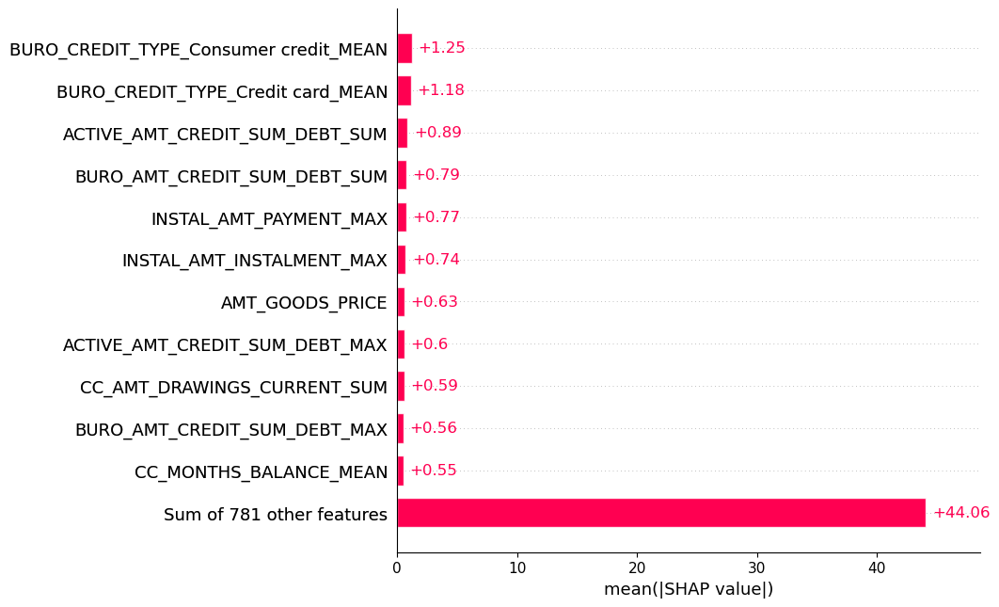

In [562]:
# split the pipeline in individual steps
imputer = pipe.named_steps['imputer']
scaler = pipe.named_steps['scaler']
clf = pipe.named_steps['clf']

# get standardized data
#X_scaled = scaler.fit_transform(imputer.fit_transform(X_test_enc))
X_train_scaled = scaler.transform(imputer.transform(X_train_bal))
X_test_scaled = scaler.transform(imputer.transform(X_test_enc))

# explain the model's predictions using SHAP
explainer = shap.LinearExplainer(clf, X_train_scaled, feature_names=X_train_bal.columns)
shap_values = explainer(X_test_scaled)

# we convert back to the original data
# (note we can do this because X_std is a set of univariate transformations of X)
shap_values.data = X_test_enc.values

# Summary of features importance
shap.plots.bar(shap_values, max_display=12)

In [574]:
# Explain the score for a single customer
line_id = 2
customer_index_id = X_test_enc.index[line_id]

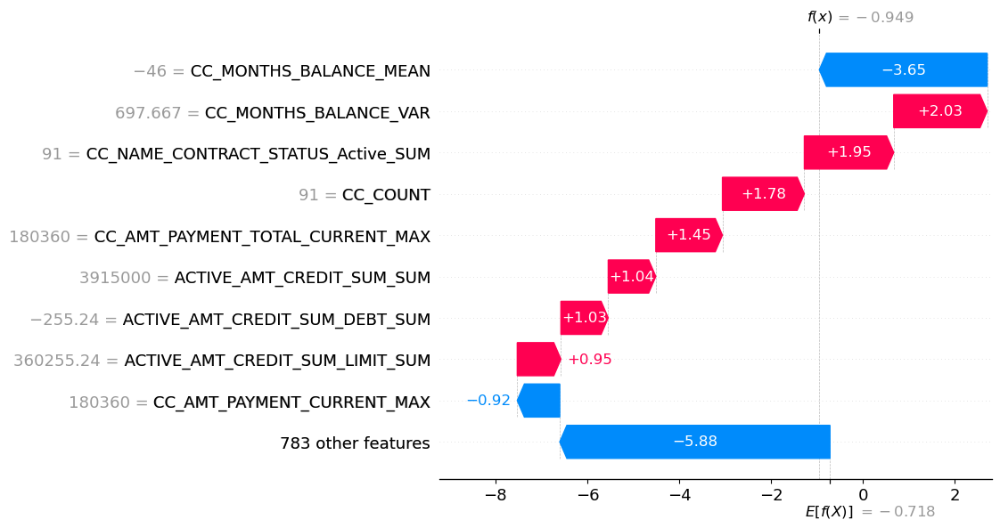

In [565]:
shap.plots.waterfall(shap_values[line_id])

Attention à l'interprétation du waterfall précédent : les valeurs correspondent à l'impact de chaque variable sur la sortie du modèle ***avant*** sigmoïde.

In [566]:
customer_shap_value = explainer.expected_value + shap_values.values[line_id].sum()
print("Valeur SHAP en sortie pour ce client : {:.4f} (avant sigmoïde)".format(customer_shap_value))
print("Probabilité de défaut de paiement pour ce client :")
print(" - méthode <predict_proba> du modèle : {:.4f}".format(pipe.predict_proba(X_test_enc.loc[X_test_enc.index == customer_index_id, :])[0][1]))
print(" - sortie SHAP après sigmoïde : {:.4f}".format(sigmoid(customer_shap_value)))

Valeur SHAP en sortie pour ce client : -0.9495 (avant sigmoïde)
Probabilité de défaut de paiement pour ce client :
 - méthode <predict_proba> du modèle : 0.2790
 - sortie SHAP après sigmoïde : 0.2790


#### From Logistic Regression Model

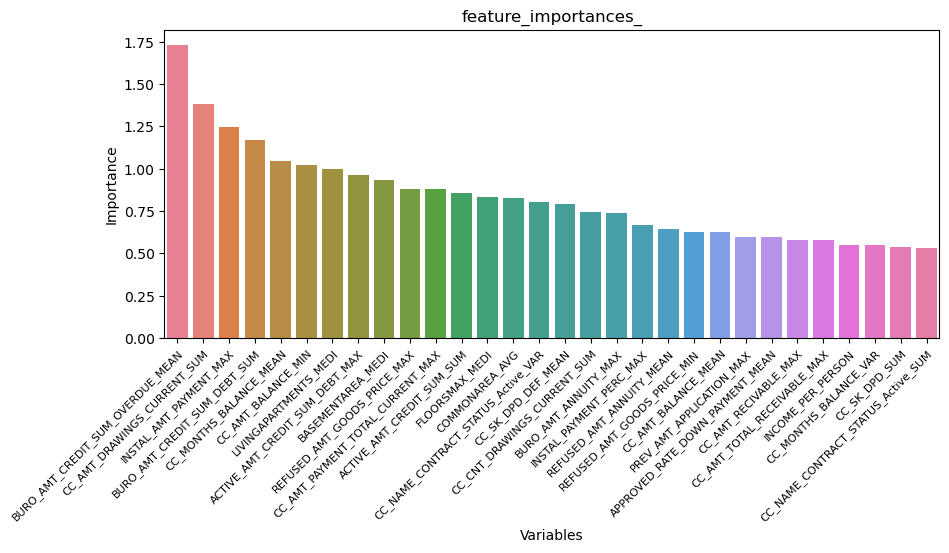

In [434]:
res = pd.DataFrame(zip(X_test_enc.columns, pipe.named_steps['clf'].coef_[0]))
res.columns = ['Variables', 'Importance']
res.sort_values('Importance', ascending = False, inplace=True)
fig = plt.figure(figsize = (10, 4))
sns.barplot(data = res[:30], x = 'Variables', y = 'Importance', palette = 'husl')
plt.xticks(rotation=45, ha = 'right', rotation_mode="anchor", size=8)
plt.title('feature_importances_')
plt.show()

## Modèle n°2 : Random Forest

In [295]:
rfc = RandomForestClassifier(n_estimators=1000, max_depth=None, class_weight='balanced')

### Entraînement du modèle

#### Optimisation des paramètres

In [296]:
# grille de paramètres
rfc_grid = {
    'n_estimators' : [20, 100, 300] # Number of trees
} 
#rfc_grid = {'n_estimators' : [1000]}

# initialiser la validation croisée
rfc_search = GridSearchCV(rfc, rfc_grid, cv=5, scoring=bank_score, verbose=3)

# On entraîne ce modèle sur les données d'entrainement
rfc_search.fit(X_train_bal, y_train_bal)

# On extrait la meilleure combinaison de paramètres
res = pd.DataFrame(rfc_search.cv_results_)[['param_n_estimators', 'mean_test_score', 'std_test_score', 'rank_test_score', 'mean_fit_time']]
res.sort_values('rank_test_score').head(10)

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END ..................n_estimators=20;, score=-2.346 total time=   2.6s
[CV 2/5] END ..................n_estimators=20;, score=-2.307 total time=   2.5s
[CV 3/5] END ..................n_estimators=20;, score=-2.248 total time=   2.6s
[CV 4/5] END ..................n_estimators=20;, score=-0.533 total time=   2.7s
[CV 5/5] END ..................n_estimators=20;, score=-0.527 total time=   2.6s
[CV 1/5] END .................n_estimators=100;, score=-2.405 total time=  12.3s
[CV 2/5] END .................n_estimators=100;, score=-2.373 total time=  12.1s
[CV 3/5] END .................n_estimators=100;, score=-2.287 total time=  12.3s
[CV 4/5] END .................n_estimators=100;, score=-0.373 total time=  12.3s
[CV 5/5] END .................n_estimators=100;, score=-0.356 total time=  12.2s
[CV 1/5] END .................n_estimators=300;, score=-2.411 total time=  36.2s
[CV 2/5] END .................n_estimators=300;, 

,param_n_estimators,mean_test_score,std_test_score,rank_test_score,mean_fit_time
2,300,-1.552428,0.992409,1,36.316702
1,100,-1.558721,0.975752,2,12.205863
0,20,-1.592150,0.867837,3,2.635508


#### Fit

In [297]:
# Le modèle est entraîné sur les données équilibrées
rfc.set_params(**rfc_search.best_params_).fit(X_train_bal, y_train_bal)
#rfc.set_params(**{'n_estimators' : 100}).fit(X_train_bal, y_train_bal)

RandomForestClassifier(class_weight='balanced', n_estimators=300)

#### Optimisation du seuil

In [298]:
# Les prédictions à partir desquelles on va chercher le seuil optimum sont faites à partir des données déséquilibrées
y_train_proba = rfc.predict_proba(X_train_enc)[:, 1]

In [299]:
rf_custom_threshold = custom_threshold_func(y_train, y_train_proba)

custom threshold : 0.47


### Test results

accuracy : 0.92
roc_auc : 0.74
bank_loss : 0.75896

Matrice de confusion :
[[11443    77]
 [  941    39]]


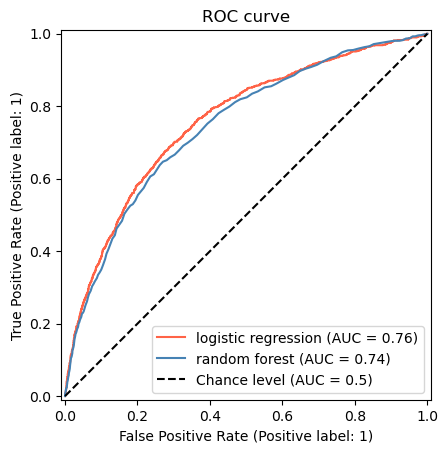

In [300]:
# Calcul des scores de classification
y_test_proba_rf = rfc.predict_proba(X_test_enc)[:, 1]

# Indicateurs de performances
rf_accuracy, rf_roc_auc, rf_bank_loss = evaluer(y_test, y_test_proba_rf, rf_custom_threshold, True)

# Affichage de la courbe ROC
lr_RocCurve.plot(color="tomato")
lr_RocCurve.ax_.set(xlabel="False Positive Rate", ylabel="True Positive Rate", title="ROC curve")
rf_RocCurve = RocCurveDisplay.from_predictions(y_test, y_test_proba_rf, name="random forest", color="steelblue", ls="-", ax=lr_RocCurve.ax_, plot_chance_level=True)
plt.show()

### Log to ML Flow

In [56]:
# Start an MLflow run
with mlflow.start_run(description="Modèle évolué : Random Forest"):
    # Log the hyperparameters
    params = rfc.get_params(deep=False)
    params['custom_threshold_for_classif'] = custom_threshold
    params['smote_sampling_strategy'] = smote_sampling_strategy
    params['undersampling_strategy'] = undersampling_strategy
    mlflow.log_params(params)

    # Log the model metrics (from test results)
    mlflow.log_metrics({"accuracy":accuracy, "roc_auc":roc_auc, "bank_loss":bank_loss})

    # Set a tag that we can use to remind ourselves what this run was for
    mlflow.set_tags({
        "Model type" : "Random Forest",
        "Nb of lines" : "10k",
        "Rebalancing method" : "Smote + undersampling",
        "Feature selection" : "None"})

    # Infer the model signature
    signature = infer_signature(X_train_bal, rfc.predict(X_train_bal))

    # Log the model
    model_info = mlflow.sklearn.log_model(
        sk_model=rfc,
        artifact_path="Kaggle Kernel with simple features (Aguiar)",
        signature=signature,
        input_example=X_train_bal,
        registered_model_name= experiment_name + "__" + "random-forest",
    )

Successfully registered model 'OC-DataScientist-P7__random-forest'.
2024/05/24 13:32:12 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: OC-DataScientist-P7__random-forest, version 1
Created version '1' of model 'OC-DataScientist-P7__random-forest'.


### Features importance

#### From SHAP

In [ ]:
#explainer = shap.TreeExplainer(rfc, X_train_bal, feature_names=X_train_bal.columns, model_output='probability')
#shap_values = explainer(X_test_enc)
#shap_values.shape

  3%|=                   | 712/25000 [05:31<188:11]       

In [ ]:
# Summary of features importance
#shap.plots.bar(shap_values, max_display=12)

#### From Random Forest model itself

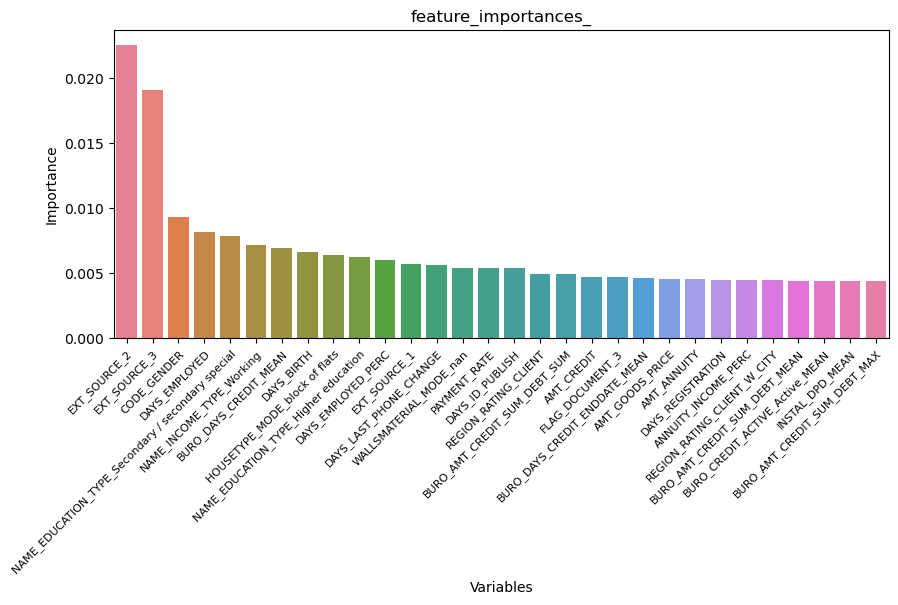

In [197]:
res = pd.DataFrame(zip(rfc.feature_names_in_, rfc.feature_importances_))
res.columns = ['Variables', 'Importance']
res.sort_values('Importance', ascending = False, inplace=True)
fig = plt.figure(figsize = (10, 4))
sns.barplot(data = res[:30], x = 'Variables', y = 'Importance', palette = 'husl')
plt.xticks(rotation=45, ha = 'right', rotation_mode="anchor", size=8)
plt.title('feature_importances_')
plt.show()

## Modèle n°3 : Gradient Boosting

In [42]:
def bank_loss_feval(preds, dataset):
    """Calculate Bank loss"""
    labels = dataset.get_label()
    tn, fp, fn, tp = confusion_matrix(labels, preds > 0.5).ravel()
    bk_loss = (10*fn + fp) / len(labels) # un crédit accordé non remboursé est évalué à un montant 10 fois plus élevé qu'un crédit solvable non accordé
    
    # # eval_name, eval_result, is_higher_better
    return 'bank_loss', bk_loss, False

In [43]:
def objective(hyperparameters, iteration):
    """Objective function for grid and random search. Returns
       the cross validation score from a set of hyperparameters."""
    
    # Number of estimators will be found using early stopping
    if 'n_estimators' in hyperparameters.keys():
        del hyperparameters['n_estimators']

    # Fixed parameters (and different from default values)
    hyperparameters['is_unbalance'] = True
    hyperparameters['objective'] = 'binary'
    hyperparameters['metric'] = 'bank_loss' # no way to early-stop based on bank_loss only if we specify other metrics here
    hyperparameters['feature_pre_filter'] = False
    hyperparameters['silent'] = -1
    hyperparameters['verbose'] = -1
    
    # Call back for early stopping
    early_stopping_cb = [lgb.early_stopping(stopping_rounds=30)]
    # early_stopping_cb = [lgb.early_stopping(stopping_rounds=30), lgb.log_evaluation(period=1, show_stdv=False)]
    
    # cv() only accepts Dataset object and it must be recreated in order to change <subsample_for_bin>'s value.
    train_set = lgb.Dataset(data=X_train_bal_renamed, label=y_train_bal)

    # Cross validation with early stopping
    cv_results = lgb.cv(hyperparameters, train_set, num_boost_round = 10000, feval=bank_loss_feval, nfold=5, seed = 1209, callbacks=early_stopping_cb)
    
    # results to return
    score = cv_results['valid bank_loss-mean'][-1]
    estimators = len(cv_results['valid bank_loss-mean'])
    hyperparameters['n_estimators'] = estimators 

    del train_set, cv_results
    gc.collect()
    
    return [score, hyperparameters, iteration]

In [44]:
def random_search(param_grid, out_file, max_evals):
    """Random search for hyperparameter optimization"""
    
    # Dataframe for results
    results = pd.DataFrame(columns = ['score', 'params', 'iteration'], index = list(range(max_evals)))
    
    # Keep searching until reach max evaluations
    for i in range(max_evals):
        print(f">>>>> EVAL n° {i} <<<<<")
        hyperparameters = {k: random.sample(v, 1)[0] for k, v in param_grid.items()} # Choose random hyperparameters

        
        eval_results = objective(hyperparameters, i) # Evaluate randomly selected hyperparameters
        results.loc[i, :] = eval_results

        # open connection (append option) and write results
        of_connection = open(out_file, 'a', newline='')
        writer = csv.writer(of_connection)
        writer.writerow(eval_results)
        # make sure to close connection
        of_connection.close()
        
    # Sort with lowest score on top
    results.sort_values('score', ascending = True, inplace = True)
    results.reset_index(inplace = True, drop=True)
    return results 

In [45]:
def grid_search(param_grid, out_file, start_eval, stop_eval):
    """Grid search algorithm (with limit on max evals)"""
    
    # Dataframe to store results
    results = pd.DataFrame(columns = ['score', 'params', 'iteration'], index = list(range(stop_eval-start_eval)))
    
    # https://codereview.stackexchange.com/questions/171173/list-all-possible-permutations-from-a-python-dictionary-of-lists
    keys, values = zip(*param_grid.items())
    
    i = 0
    # Iterate through every possible combination of hyperparameters
    all_combinations = list(itertools.product(*values))
    searched_combinations = all_combinations[start_eval:stop_eval]
    
    for v in searched_combinations:
        print(f">>>>> EVAL n° {i} <<<<<")
        
        # Create a hyperparameter dictionary
        hyperparameters = dict(zip(keys, v))

        # Evalute the hyperparameters
        eval_results = objective(hyperparameters, i)       
        results.loc[i, :] = eval_results

        # open connection (append option) and write results
        of_connection = open(out_file, 'a', newline='')
        writer = csv.writer(of_connection)
        writer.writerow(eval_results)
        # make sure to close connection
        of_connection.close()
        
        i += 1
       
    # Sort with lowest score on top
    results.sort_values('score', ascending = True, inplace = True)
    results.reset_index(inplace = True, drop=True)
    
    return results 

In [46]:
def top_N_params(params_grid, results_grid, N=10):
    """ Display the TOP-N parameters set according to results grid """
    # best params sets
    top_N_params = pd.DataFrame(columns = params_grid.keys(), index=range(N))
    for r in range(N) : # r = result index
        for i, p in enumerate(params_grid.keys()) : # p = parameter index
           top_N_params.iloc[r, i] = results_grid['params'][r][p]

    # add the score columns
    top_N_params['score'] = results_grid.iloc[:N, 0]
    return top_N_params

### Entraînement du modèle

In [47]:
# Remove special JSON characters from columns name
new_cols = []
for col_name in X_train_bal.columns : new_cols.append(''.join(letter for letter in col_name if (letter.isalnum() or letter=='_')))
X_train_bal_renamed = X_train_bal.copy()
X_train_bal_renamed.columns = new_cols

In [231]:
X_train_bal.columns[400:420]

Index(['LIVE_CITY_NOT_WORK_CITY', 'LIVE_REGION_NOT_WORK_REGION',
       'LIVINGAPARTMENTS_AVG', 'LIVINGAPARTMENTS_MEDI',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_AVG', 'LIVINGAREA_MEDI',
       'LIVINGAREA_MODE', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE_Academic degree',
       'NAME_EDUCATION_TYPE_Higher education',
       'NAME_EDUCATION_TYPE_Incomplete higher',
       'NAME_EDUCATION_TYPE_Lower secondary',
       'NAME_EDUCATION_TYPE_Secondary / secondary special',
       'NAME_FAMILY_STATUS_Civil marriage', 'NAME_FAMILY_STATUS_Married',
       'NAME_FAMILY_STATUS_Separated',
       'NAME_FAMILY_STATUS_Single / not married', 'NAME_FAMILY_STATUS_Widow',
       'NAME_HOUSING_TYPE_Co-op apartment'],
      dtype='object')

In [232]:
X_train_bal_renamed.columns[400:420]

Index(['LIVE_CITY_NOT_WORK_CITY', 'LIVE_REGION_NOT_WORK_REGION',
       'LIVINGAPARTMENTS_AVG', 'LIVINGAPARTMENTS_MEDI',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_AVG', 'LIVINGAREA_MEDI',
       'LIVINGAREA_MODE', 'NAME_CONTRACT_TYPE',
       'NAME_EDUCATION_TYPE_Academicdegree',
       'NAME_EDUCATION_TYPE_Highereducation',
       'NAME_EDUCATION_TYPE_Incompletehigher',
       'NAME_EDUCATION_TYPE_Lowersecondary',
       'NAME_EDUCATION_TYPE_Secondarysecondaryspecial',
       'NAME_FAMILY_STATUS_Civilmarriage', 'NAME_FAMILY_STATUS_Married',
       'NAME_FAMILY_STATUS_Separated', 'NAME_FAMILY_STATUS_Singlenotmarried',
       'NAME_FAMILY_STATUS_Widow', 'NAME_HOUSING_TYPE_Coopapartment'],
      dtype='object')

In [221]:
X_train_bal_renamed.columns

Index(['ACTIVE_AMT_ANNUITY_MAX', 'ACTIVE_AMT_ANNUITY_MEAN',
       'ACTIVE_AMT_CREDIT_MAX_OVERDUE_MEAN', 'ACTIVE_AMT_CREDIT_SUM_DEBT_MAX',
       'ACTIVE_AMT_CREDIT_SUM_DEBT_MEAN', 'ACTIVE_AMT_CREDIT_SUM_DEBT_SUM',
       'ACTIVE_AMT_CREDIT_SUM_LIMIT_MEAN', 'ACTIVE_AMT_CREDIT_SUM_LIMIT_SUM',
       'ACTIVE_AMT_CREDIT_SUM_MAX', 'ACTIVE_AMT_CREDIT_SUM_MEAN',
       ...
       'WEEKDAY_APPR_PROCESS_START_SUNDAY',
       'WEEKDAY_APPR_PROCESS_START_THURSDAY',
       'WEEKDAY_APPR_PROCESS_START_TUESDAY',
       'WEEKDAY_APPR_PROCESS_START_WEDNESDAY', 'YEARS_BEGINEXPLUATATION_AVG',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_AVG', 'YEARS_BUILD_MEDI', 'YEARS_BUILD_MODE'],
      dtype='object', length=792)

In [58]:
# Liste complète des paramètres dont ceux adaptés à notre étude :
lgbm = lgb.LGBMClassifier(class_weight='balanced', is_unbalance=True, objective='binary', metrics=['auc', 'binary_error'], feature_pre_filter=False, silent=-1, verbose=-1,)
basic_params = lgbm.get_params()
basic_params

{'boosting_type': 'gbdt',
 'class_weight': 'balanced',
 'colsample_bytree': 1.0,
 'importance_type': 'split',
 'learning_rate': 0.1,
 'max_depth': -1,
 'min_child_samples': 20,
 'min_child_weight': 0.001,
 'min_split_gain': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'num_leaves': 31,
 'objective': 'binary',
 'random_state': None,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'subsample': 1.0,
 'subsample_for_bin': 200000,
 'subsample_freq': 0,
 'is_unbalance': True,
 'metrics': ['auc', 'binary_error'],
 'feature_pre_filter': False,
 'silent': -1,
 'verbose': -1}

In [59]:
temps_init = time.time()
test_basique = objective(basic_params, 0) # Evaluate randomly selected hyperparameters
duree_unitaire = round(time.time()-temps_init, 1)
print(f"\nDurée d'un round limité par l'early stopping : {duree_unitaire} secondes")

Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[51]	cv_agg's valid bank_loss: 0.857809 + 0.0443441

Durée d'un round limité par l'early stopping : 13.0 secondes


#### Optimisation des paramètres : Random Search

In [54]:
# Hyperparameter grid
random_params = {
    'num_leaves': list(range(20, 50, 4)),
    'learning_rate': list(np.logspace(np.log10(0.005), np.log10(0.5), base = 10, num = 20)),
    'subsample_for_bin': [10000, 50000, 200000],
    'min_child_samples': list(range(100, 500, 50)),
    'reg_alpha': list(np.linspace(0, 0.5, 20)),
    'reg_lambda': list(np.linspace(0, 0.5, 20)),
    'colsample_bytree': list(np.linspace(0.6, 1, 10)),
    'subsample': list(np.linspace(0.5, 1, 10))
}

In [66]:
# Nb de combinaisons de paramètres :
com = 1
for x in random_params.values():
    com *= len(x)

# Durée d'évaluation d'une combinaires
duree = int(duree_unitaire)

# Réflexion 1 :
print('There are {} combinations'.format(com))
print('If we assume {:2d} seconds per evaluation...'.format(duree))
print('\t... this would take {:2d} years to finish.'.format(int((duree * com) / (60 * 60 * 24 * 365))))

# Réflexion 2 : 
print("Disons qu'on accepte de patienter 1/2 heure...")
print("\t... cela nous permet de tester {:2d} combinaisons.".format(int(30 * 60 / duree)))

There are 153600000 combinations
If we assume  5 seconds per evaluation...
	... this would take 24 years to finish.
Disons qu'on accepte de patienter 1/2 heure...
	... cela nous permet de tester 360 combinaisons.


In [67]:
# Run this cell to launch random search
# #####################################

# Create file + open connection
path_to_results = "../results/random_search_10k/"
out_file = path_to_results + 'Trials_000_200CD.csv'
of_connection = open(out_file, 'w', newline='')
writer = csv.writer(of_connection)

# Write column names
headers = ['score', 'hyperparameters', 'iteration']
writer.writerow(headers)
of_connection.close()

# Launch random search
MAX_EVALS = 200
random_results = random_search(random_params, out_file, MAX_EVALS)

>>>>> EVAL n° 0 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[21]	cv_agg's valid bank_loss: 0.814611 + 0.067012
>>>>> EVAL n° 1 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[196]	cv_agg's valid bank_loss: 0.800479 + 0.0663547
>>>>> EVAL n° 2 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[41]	cv_agg's valid bank_loss: 0.786587 + 0.102434
>>>>> EVAL n° 3 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[274]	cv_agg's valid bank_loss: 0.775329 + 0.0452409
>>>>> EVAL n° 4 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[34]	cv_agg's valid bank_loss: 0.791377 + 0.0790651
>>>>> EVAL n° 5 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[17]	cv_agg's valid bank_loss: 0

In [55]:
# Run this cell to load previous results from random search
# #########################################################
path_to_results = "../results/random_search_50k/"
random_results = pd.DataFrame(columns = ['score', 'hyperparameters', 'iteration'])

# concatenate all available results
for file in os.listdir(path_to_results) :
    file_results = pd.read_csv(path_to_results + file)
    random_results = pd.concat( [random_results, file_results], ignore_index = True )
random_results.columns = ['score', 'params', 'iteration']
random_results.pop("iteration")

# Convert strings to dictionaries (when we save the results to a csv, for some reason the dictionaries are saved as strings...)
random_results['params'] = random_results['params'].map(ast.literal_eval)

# Sort with lowest score on top
random_results.sort_values('score', ascending = True, inplace = True)
random_results.reset_index(inplace = True, drop=True)

In [56]:
# Display top-N parameters sets
random_top = top_N_params(random_params, random_results, 10)
random_top

,num_leaves,learning_rate,subsample_for_bin,min_child_samples,reg_alpha,reg_lambda,colsample_bytree,subsample,score
0,36,0.056442,10000,450,0.5,0.0,0.777778,0.555556,0.805611
1,20,0.016799,10000,400,0.052632,0.5,0.911111,1.0,0.805706
2,45,0.107722,200000,470,0.447368,0.315789,0.866667,0.6,0.805993
3,20,0.038713,200000,350,0.236842,0.394737,0.911111,0.6,0.809116
4,20,0.023208,200000,350,0.447368,0.0,0.777778,0.7,0.811085
5,20,0.013913,50000,370,0.131579,0.315789,0.911111,0.8,0.811085
6,25,0.038713,200000,470,0.342105,0.210526,0.911111,1.0,0.811564
7,20,0.064577,10000,400,0.368421,0.447368,0.777778,0.8,0.811564
8,20,0.116786,200000,400,0.342105,0.157895,0.866667,0.722222,0.811613
9,20,0.013913,50000,400,0.342105,0.473684,1.0,1.0,0.812141


#### Optimisation des paramètres : Grid Search

In [48]:
# More precised hyperparameter grid : => 250 combinations
grid_params = {
    'num_leaves': [20],
    'learning_rate': list(np.linspace(0.06, 0.12, 5)),
    'subsample_for_bin': [200000],
    'min_child_samples': [350],
    'reg_alpha': list(np.linspace(0.35, 0.4, 5)),
    'reg_lambda': list(np.linspace(0.05, 0.1, 5)),
    'colsample_bytree': [0.96],
    'subsample': [0.78]
}

In [318]:
# Run this cell to launch grid search
# #####################################

# Create file + open connection
path_to_results = "../results/grid_search_50k/"
out_file = path_to_results + 'Trials_000_125D.csv'
of_connection = open(out_file, 'w', newline='')
writer = csv.writer(of_connection)

# Write column names
headers = ['score', 'hyperparameters', 'iteration']
writer.writerow(headers)
of_connection.close()

# Launch grid search
START_EVAL = 0
STOP_EVAL = 125

grid_results = grid_search(grid_params, out_file, START_EVAL, STOP_EVAL)

>>>>> EVAL n° 0 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[122]	cv_agg's valid bank_loss: 0.814302 + 0.0319044
>>>>> EVAL n° 1 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[102]	cv_agg's valid bank_loss: 0.813293 + 0.0333458
>>>>> EVAL n° 2 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[83]	cv_agg's valid bank_loss: 0.814158 + 0.0335384
>>>>> EVAL n° 3 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[91]	cv_agg's valid bank_loss: 0.814494 + 0.03482
>>>>> EVAL n° 4 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[114]	cv_agg's valid bank_loss: 0.815645 + 0.021838
>>>>> EVAL n° 5 <<<<<
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[109]	cv_agg's valid bank_loss: 

In [49]:
# Run this cell to load previous results from grid search
# #########################################################
path_to_results = "../results/grid_search_50k/"
grid_results = pd.DataFrame(columns = ['score', 'hyperparameters', 'iteration'])

# concatenate all available results
for file in os.listdir(path_to_results) :
    file_results = pd.read_csv(path_to_results + file)
    grid_results = pd.concat( [grid_results, file_results], ignore_index = True )
grid_results.columns = ['score', 'params', 'iteration']
grid_results.pop("iteration")

# Convert strings to dictionaries (when we save the results to a csv, for some reason the dictionaries are saved as strings...)
grid_results['params'] = grid_results['params'].map(ast.literal_eval)

# Sort with lowest score on top
grid_results.sort_values('score', ascending = True, inplace = True)
grid_results.reset_index(inplace = True, drop=True)

In [50]:
# Display top-N parameters sets
grid_top = top_N_params(grid_params, grid_results, 15)
grid_top

,num_leaves,learning_rate,subsample_for_bin,min_child_samples,reg_alpha,reg_lambda,colsample_bytree,subsample,score
0,20,0.0475,10000,370,0.5,0.2,1,0.6,0.800808
1,20,0.035,10000,370,0.5,0.4,1,0.6,0.802488
2,20,0.06,10000,370,0.425,0.5,1,0.6,0.803737
3,20,0.06,10000,370,0.5,0.4,1,0.6,0.803977
4,20,0.0475,10000,370,0.35,0.1,1,0.6,0.804122
5,20,0.0475,10000,370,0.275,0.2,1,0.6,0.804938
6,20,0.0475,10000,370,0.425,0.1,1,0.6,0.805131
7,20,0.0225,10000,370,0.5,0.4,1,0.6,0.805178
8,20,0.02,200000,350,0.25,0.41,0.91,0.6,0.805467
9,20,0.0475,10000,370,0.425,0.2,1,0.6,0.805659


#### Fit

In [51]:
# Best params found from grid search
test_params = grid_results.loc[0, 'params']
# + fixed params as in grid search
test_params['is_unbalance'] = True
test_params['objective'] = 'binary'
test_params['metrics'] = 'bank_loss'

print("Parameters set used for test data :")
pprint.pprint(test_params)

Parameters set used for test data :
{'colsample_bytree': 1,
 'feature_pre_filter': False,
 'is_unbalance': True,
 'learning_rate': 0.0475,
 'metric': 'bank_loss',
 'metrics': 'bank_loss',
 'min_child_samples': 370,
 'n_estimators': 131,
 'num_leaves': 20,
 'objective': 'binary',
 'reg_alpha': 0.5,
 'reg_lambda': 0.2,
 'silent': -1,
 'subsample': 0.6,
 'subsample_for_bin': 10000,
 'verbose': -1}


In [52]:
temps_init = time.time()
# Implement an lgbm model
lgbm = lgb.LGBMClassifier(**test_params, random_state=1209,)

# Fit
lgbm.fit(X_train_bal_renamed, y_train_bal)

duree_modelisation = round(time.time()-temps_init, 1)
print(f"\nDurée d'entraînement du modèle LightGBM avec hyperparamètres optimisés : {duree_modelisation} secondes")


Durée d'entraînement du modèle LightGBM avec hyperparamètres optimisés : 3.3 secondes


#### Optimisation du seuil

In [53]:
# Les prédictions à partir desquelles on va chercher le seuil optimum sont faites à partir des données déséquilibrées
y_train_proba = lgbm.predict_proba(X_train_enc)[:, 1]

In [54]:
lgbm_custom_threshold = custom_threshold_func(y_train, y_train_proba)

custom threshold : 0.50


### Test results


Durée de prédiction par le modèle LightGBM avec hyperparamètres optimisés : 0.1 secondes

accuracy : 0.71
roc_auc : 0.74
bank_loss : 0.5432

Matrice de confusion :
[[8180 3340]
 [ 345  635]]


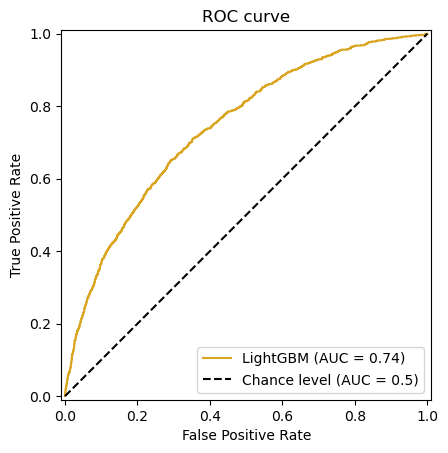

In [55]:
temps_init = time.time()
# Calcul des scores de classification
y_test_proba_lgbm = lgbm.predict_proba(X_test_enc)[:, 1]

duree_modelisation = round(time.time()-temps_init, 1)
print(f"\nDurée de prédiction par le modèle LightGBM avec hyperparamètres optimisés : {duree_modelisation} secondes\n")

# Indicateurs de performances
lgbm_accuracy, lgbm_roc_auc, lgbm_bank_loss = evaluer(y_test, y_test_proba_lgbm, lgbm_custom_threshold, True)

# Affichage de la courbe ROC

lgbm_RocCurve = RocCurveDisplay.from_predictions(y_test, y_test_proba_lgbm, name="LightGBM", color="goldenrod", ls="-",  plot_chance_level=True)
lgbm_RocCurve.ax_.set(xlabel="False Positive Rate", ylabel="True Positive Rate", title="ROC curve")
plt.show()




Durée de prédiction par le modèle LightGBM avec hyperparamètres optimisés : 0.1 secondes

accuracy : 0.71
roc_auc : 0.74
bank_loss : 0.5432

Matrice de confusion :
[[8180 3340]
 [ 345  635]]


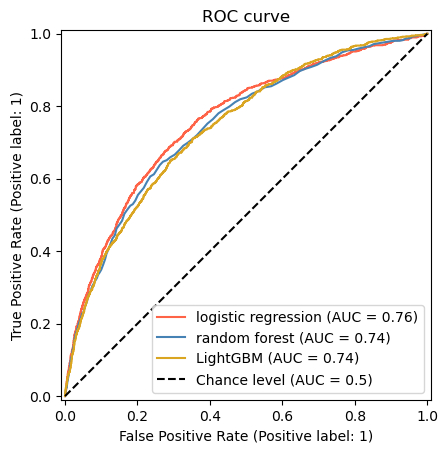

In [326]:
temps_init = time.time()
# Calcul des scores de classification
y_test_proba_lgbm = lgbm.predict_proba(X_test_enc)[:, 1]

duree_modelisation = round(time.time()-temps_init, 1)
print(f"\nDurée de prédiction par le modèle LightGBM avec hyperparamètres optimisés : {duree_modelisation} secondes\n")

# Indicateurs de performances
lgbm_accuracy, lgbm_roc_auc, lgbm_bank_loss = evaluer(y_test, y_test_proba_lgbm, lgbm_custom_threshold, True)

# Affichage de la courbe ROC
lr_RocCurve.plot(color="tomato")
lr_RocCurve.ax_.set(xlabel="False Positive Rate", ylabel="True Positive Rate", title="ROC curve")
rf_RocCurve = RocCurveDisplay.from_predictions(y_test, y_test_proba_rf, name="random forest", color="steelblue", ls="-", ax=lr_RocCurve.ax_)
lgbm_RocCurve = RocCurveDisplay.from_predictions(y_test, y_test_proba_lgbm, name="LightGBM", color="goldenrod", ls="-", ax=lr_RocCurve.ax_, plot_chance_level=True)
plt.show()



### Log to ML Flow

In [89]:
# Start an MLflow run
with mlflow.start_run(description="Modèle évolué : LightGBM"):
    # Log the hyperparameters
    params = lgbm.get_params(deep=False)
    params['custom_threshold_for_classif'] = custom_threshold
    params['smote_sampling_strategy'] = smote_sampling_strategy
    params['undersampling_strategy'] = undersampling_strategy
    mlflow.log_params(params)

    # Log the model metrics (from test results)
    mlflow.log_metrics({"accuracy":accuracy, "roc_auc":roc_auc, "bank_loss":bank_loss})

    # Set a tag that we can use to remind ourselves what this run was for
    mlflow.set_tags({
        "Model type" : "Gradient Boosting",
        "Nb of lines" : "10k",
        "Rebalancing method" : "Smote + undersampling",
        "Feature selection" : "None"})

    # Infer the model signature
    signature = infer_signature(X_train_bal, lgbm.predict(X_train_bal))

    # Log the model
    model_info = mlflow.sklearn.log_model(
        sk_model=lgbm,
        artifact_path="Kaggle Kernel with simple features (Aguiar)",
        signature=signature,
        input_example=X_train_bal,
        registered_model_name= experiment_name + "__" + "lightgbm",
    )

Successfully registered model 'OC-DataScientist-P7__lightgbm'.
2024/05/24 14:36:42 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: OC-DataScientist-P7__lightgbm, version 1
Created version '1' of model 'OC-DataScientist-P7__lightgbm'.


### Features importance

#### SHAP Global features importance

In [56]:
explainer = shap.TreeExplainer(lgbm, X_train_bal_renamed, feature_names=X_train_bal_renamed.columns, model_output='probability')
shap_values = explainer(X_test_enc)
shap_values.shape

 99%|===================| 12409/12500 [00:58<00:00]        

(12500, 792)

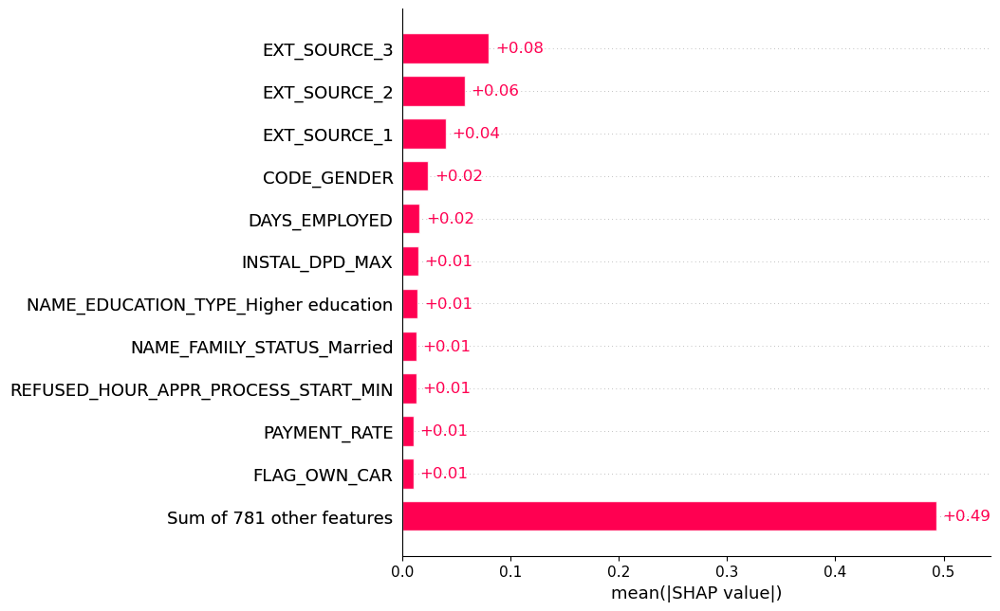

In [57]:
shap.plots.bar(shap_values, max_display=12)

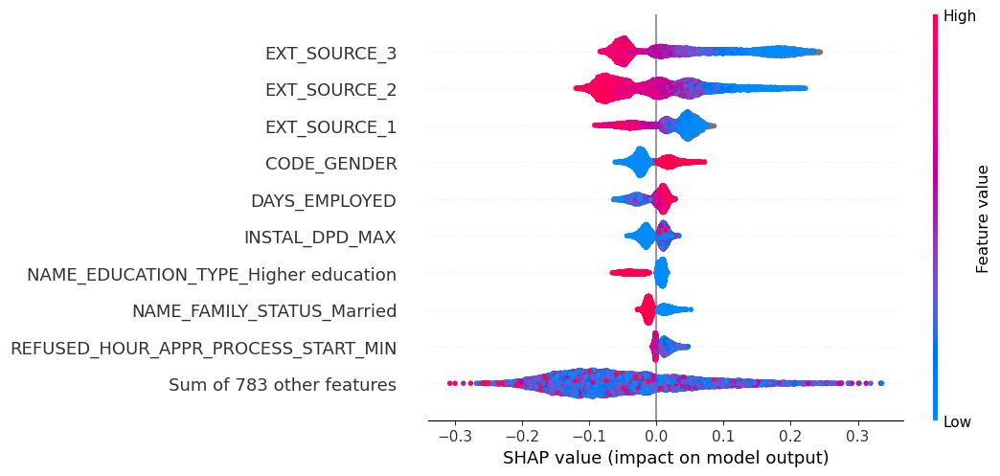

In [66]:
shap.plots.beeswarm(shap_values)

From the beeswarm plot, we can see that :
- The model predicts a higher risk of payment default for customers with CODE_GENDER = 1 (which corresponds to'Male').
- The model predicts a lower risk of payment default for customers whose FAMILY_STATUS is 'Married'.

#### SHAP Local features importance

In [67]:
# Explain the score for a single customer
line_id = 16 # any value...
customer_index_id = X_test_enc.index[line_id]

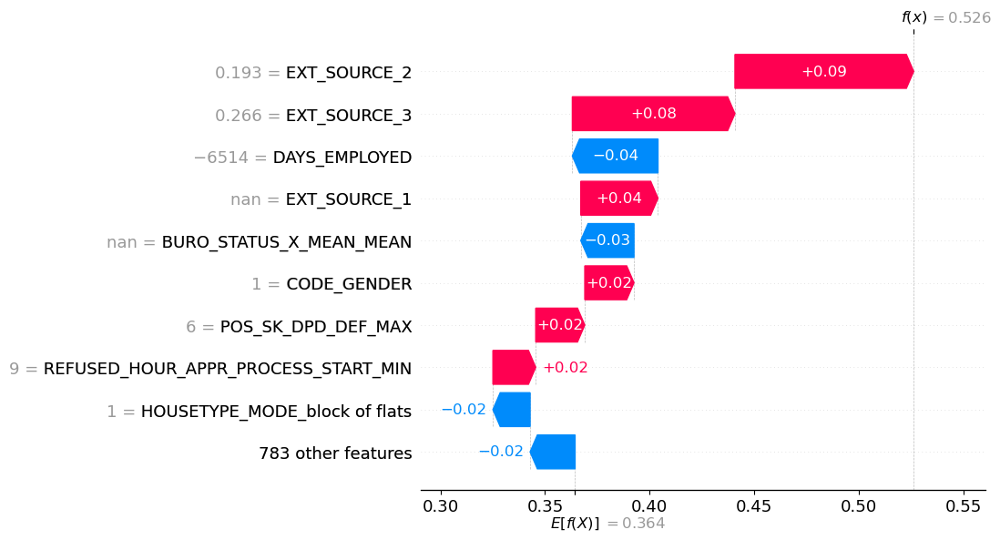

In [68]:
shap.plots.waterfall(shap_values[line_id])

On vérifie que la valeur expliquée par SHAP correspond à la valeur prédite par le modèle :

In [69]:
customer_shap_value = explainer.expected_value + shap_values.values[line_id].sum()
print("Probabilité de défaut de paiement pour ce client :")
print(" - méthode <predict_proba> du modèle : {:.4f}".format(lgbm.predict_proba(X_test_enc.loc[X_test_enc.index == customer_index_id, :])[0][1]))
print(" - valeur de sortie expliquée par SHAP : {:.4f}".format(customer_shap_value))

Probabilité de défaut de paiement pour ce client :
 - méthode <predict_proba> du modèle : 0.5262
 - valeur de sortie expliquée par SHAP : 0.5262


In [70]:
# Explain the score for a single customer
shap.plots.force(shap_values[line_id])

#### SHAP for project 8

In [71]:
shap_values.shape

(12500, 792)

In [72]:
shap_values[1, :3]

.values =
array([0.        , 0.        , 0.00084258])

.base_values =
0.36438781811398974

.data =
array([      nan,       nan, 12239.955])

In [73]:
shap_values.values[1, :3]

array([0.        , 0.        , 0.00084258])

In [74]:
X_test_enc.head()

,ACTIVE_AMT_ANNUITY_MAX,ACTIVE_AMT_ANNUITY_MEAN,ACTIVE_AMT_CREDIT_MAX_OVERDUE_MEAN,ACTIVE_AMT_CREDIT_SUM_DEBT_MAX,ACTIVE_AMT_CREDIT_SUM_DEBT_MEAN,ACTIVE_AMT_CREDIT_SUM_DEBT_SUM,ACTIVE_AMT_CREDIT_SUM_LIMIT_MEAN,ACTIVE_AMT_CREDIT_SUM_LIMIT_SUM,ACTIVE_AMT_CREDIT_SUM_MAX,ACTIVE_AMT_CREDIT_SUM_MEAN,...,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,YEARS_BEGINEXPLUATATION_AVG,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_AVG,YEARS_BUILD_MEDI,YEARS_BUILD_MODE
19314,NaN,NaN,0.000,437096.835,120816.288,604081.440,25950.294,129751.47,450000.0,270000.000,...,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
22120,NaN,NaN,12239.955,913055.400,744574.950,1489149.900,0.000,0.00,1125000.0,900000.000,...,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
7719,NaN,NaN,1800.000,-17.685,-127.620,-255.240,180127.620,360255.24,3780000.0,1305000.000,...,0.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
26088,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,1.0,0.0,0.9901,0.9901,0.9901,0.864,0.8658,0.8693
6442,0.0,0.0,4019.805,1053461.565,217088.613,1085443.065,0.000,0.00,1539000.0,350366.364,...,0.0,0.0,0.0,0.0,0.9613,0.9613,0.9613,NaN,NaN,NaN


In [76]:
shap_values.values[:, 0].max()

0.0

In [77]:
X_test_enc['ACTIVE_AMT_ANNUITY_MAX'].describe()

count    2.510000e+03
mean     3.747136e+04
std      8.550326e+05
min      0.000000e+00
25%      0.000000e+00
50%      1.150875e+04
75%      2.626988e+04
max      4.281300e+07
Name: ACTIVE_AMT_ANNUITY_MAX, dtype: float64

In [86]:
a = np.array([-2, 1, 4])

In [87]:
a.mean()

1.0

In [90]:
np.abs(a).mean()

2.3333333333333335

In [93]:
explainer.feature_names

Index(['ACTIVE_AMT_ANNUITY_MAX', 'ACTIVE_AMT_ANNUITY_MEAN',
       'ACTIVE_AMT_CREDIT_MAX_OVERDUE_MEAN', 'ACTIVE_AMT_CREDIT_SUM_DEBT_MAX',
       'ACTIVE_AMT_CREDIT_SUM_DEBT_MEAN', 'ACTIVE_AMT_CREDIT_SUM_DEBT_SUM',
       'ACTIVE_AMT_CREDIT_SUM_LIMIT_MEAN', 'ACTIVE_AMT_CREDIT_SUM_LIMIT_SUM',
       'ACTIVE_AMT_CREDIT_SUM_MAX', 'ACTIVE_AMT_CREDIT_SUM_MEAN',
       ...
       'WEEKDAY_APPR_PROCESS_START_SUNDAY',
       'WEEKDAY_APPR_PROCESS_START_THURSDAY',
       'WEEKDAY_APPR_PROCESS_START_TUESDAY',
       'WEEKDAY_APPR_PROCESS_START_WEDNESDAY', 'YEARS_BEGINEXPLUATATION_AVG',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_AVG', 'YEARS_BUILD_MEDI', 'YEARS_BUILD_MODE'],
      dtype='object', length=792)

In [58]:
# build a dataframe containing shap values
shap_df = pd.DataFrame(shap_values.values, columns=explainer.feature_names, index=X_test_enc.index) 
shap_df.shape

(12500, 792)

In [59]:
# build a dataframe containing mean( abs(shap values) ) for each feature
# > build a empty dataframe where each row is a feature
fgi = pd.DataFrame(np.zeros((len(explainer.feature_names), 2)), columns=['feature', 'importance'])
fgi['feature'] = X_train_bal.columns #explainer.feature_names

# > calculate mean( abs(shap values) ) for each row
for f in explainer.feature_names :
    fgi.loc[fgi['feature'] == f, 'importance'] = shap_df[f].abs().mean()

# > sort descending and add cumulative value
fgi.sort_values('importance', ascending = False, inplace=True)
fgi.reset_index(inplace=True, names='feature_id')
fgi['importance_cum'] = fgi['importance'].cumsum() / fgi['importance'].sum()  # normalized to get a total of 100%
fgi.head()

,feature_id,feature,importance,importance_cum
0,324,EXT_SOURCE_3,0.080012,0.108694
1,323,EXT_SOURCE_2,0.057550,0.186874
2,322,EXT_SOURCE_1,0.039853,0.241013
3,303,CODE_GENDER,0.023681,0.273184
4,308,DAYS_EMPLOYED,0.015929,0.294823


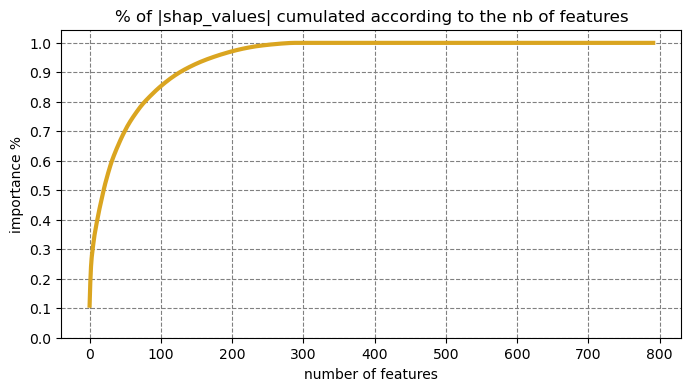

In [60]:
# Plot 
fig = plt.figure(figsize = (8, 4))
ax = fig.add_subplot(111)
sns.lineplot(data=fgi, x=fgi.index, y='importance_cum', lw=3, color='goldenrod')
plt.yticks(np.arange(0, 1.1, step=0.1))
plt.xlabel('number of features', size=10)
plt.ylabel('importance %', size=10)
ax.grid(visible=True, color='gray', linestyle='dashed')
plt.title('% of |shap_values| cumulated according to the nb of features', size=12)
plt.show()

In order to keep 90% of |shap_values|'s total, we'll use the 140 most important features.

In [61]:
print(f"140 most important features corresponds to a cumulative sum of {fgi.iloc[140, 3].round(3)}")

140 most important features corresponds to a cumulative sum of 0.918


In [62]:
# Most Important Features :
mif = fgi['feature'][:140]
mif

0                              EXT_SOURCE_3
1                              EXT_SOURCE_2
2                              EXT_SOURCE_1
3                               CODE_GENDER
4                             DAYS_EMPLOYED
                       ...                 
135                 INSTAL_PAYMENT_DIFF_VAR
136    PREV_NAME_GOODS_CATEGORY_Mobile_MEAN
137       WEEKDAY_APPR_PROCESS_START_FRIDAY
138                    PREV_AMT_ANNUITY_MAX
139                   CC_MONTHS_BALANCE_VAR
Name: feature, Length: 140, dtype: object

#### From LightGBM model itself

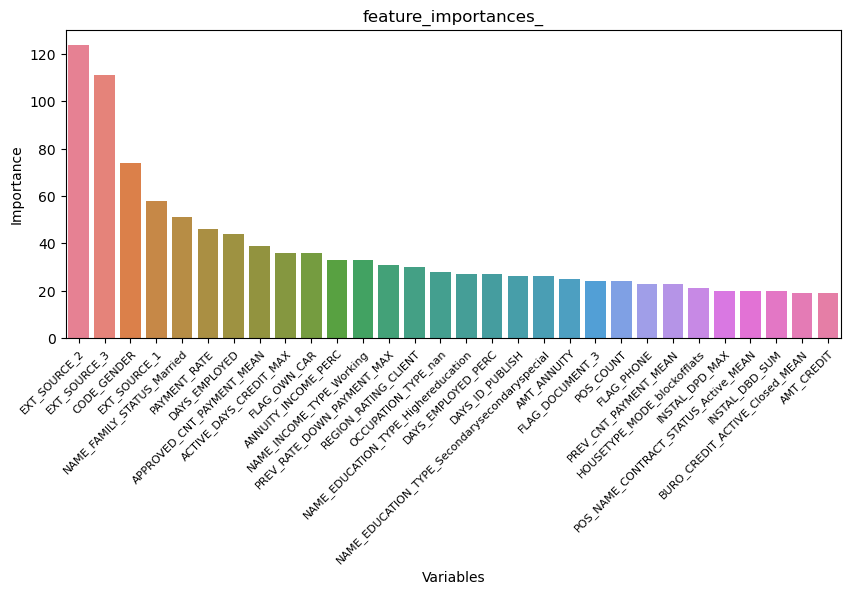

In [75]:
res = pd.DataFrame(zip(lgbm.feature_name_, lgbm.feature_importances_))
res.columns = ['Variables', 'Importance']
res.sort_values('Importance', ascending = False, inplace=True)
fig = plt.figure(figsize = (10, 4))
sns.barplot(data = res[:30], x = 'Variables', y = 'Importance', palette = 'husl')
plt.xticks(rotation=45, ha = 'right', rotation_mode="anchor", size=8)
plt.title('feature_importances_')
plt.show()

In [712]:
N_features = 8
top_features = res[:N_features]['Variables'].values
top_features

array(['EXT_SOURCE_2', 'EXT_SOURCE_3', 'CODE_GENDER', 'EXT_SOURCE_1',
       'NAME_FAMILY_STATUS_Married', 'PAYMENT_RATE', 'DAYS_EMPLOYED',
       'APPROVED_CNT_PAYMENT_MEAN'], dtype=object)

## Comparaison des modèles

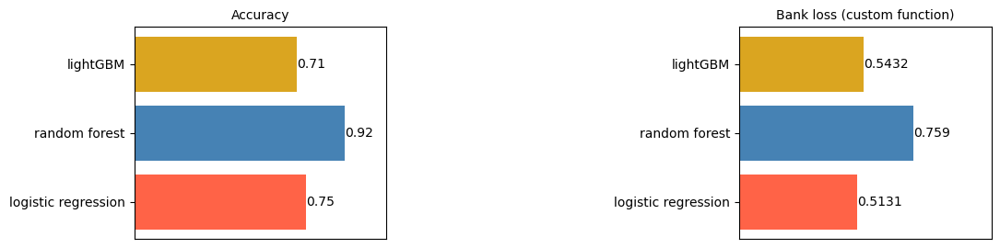

In [327]:
modeles_noms = ['logistic regression', 'random forest', 'lightGBM']
modeles_accuracy = np.round([lr_accuracy, rf_accuracy, lgbm_accuracy], 4)
modeles_bank_loss = np.round([lr_bank_loss, rf_bank_loss, lgbm_bank_loss], 4)
colors = ['tomato', 'steelblue', 'goldenrod']

fig = plt.figure(figsize = (12, 3))

# plot accuracy
ax = fig.add_subplot(1, 3, 1)
bars = ax.barh(y = modeles_noms, width = modeles_accuracy, color=colors)
ax.bar_label(bars)
ax.get_xaxis().set_visible(False)
plt.xlim(0, 1.1)
plt.title('Accuracy', fontsize = 10)

# plot bank loss
ax = fig.add_subplot(1, 3, 3)
bars = ax.barh(y = modeles_noms, width = modeles_bank_loss, color=colors)
ax.bar_label(bars)
ax.get_xaxis().set_visible(False)
plt.xlim(0, 1.1)
plt.title('Bank loss (custom function)', fontsize = 10)

plt.show()

# Submission File

## Assembling Submission Data ("Kaggle Test")

In [631]:
# load Min file
nombre_de_lignes = None
app_kaggle_test = main_file('test', nombre_de_lignes)

Tailles des données d'origine : (48744, 121)
Tailles des données avec features ajoutées : (48744, 126)


In [632]:
# Encodage
X_sub_enc = encodeur(app_kaggle_test)

Tailles des données avant encodage des variables catégorielles : (48744, 126)
Tailles des données après encodage des variables catégorielles : (48744, 247)


In [633]:
## Add features from secondary files
X_sub_enc = add_variables(X_sub_enc)

Tailles des données avant enrichissement : (48744, 247)
------------------------------------------
bureau.csv & bureau_balance.csv - Tailles des données chargées : (42320, 113)
bureau.csv & bureau_balance.csv - Traité en 14s
previous_applications.csv - Tailles des données chargées : (47800, 248)
previous_applications - Traité en 9s
POS_CASH_balance.csv - Tailles des données chargées : (47808, 17)
POS_CASH_balance.csv - Traité en 7s
installments_payments.csv - Tailles des données chargées : (47944, 26)
installments_payments.csv - Traité en 12s
credit_card_balance.csv - Tailles des données chargées : (16653, 136)
credit_card_balance.csv - Traité en 9s
------------------------------------------
Tailles des données après enrichissement : (48744, 787)


In [634]:
# Alignement des colonnes de X_sub sur X_train
X_sub_enc = aligner(X_sub_enc, X_train_enc)
X_sub_enc.sort_index(axis=1, inplace=True)
X_sub_enc.shape

(48744, 792)

## Create submission file

In [202]:
# Make the submission dataframe
test_ids = X_sub_enc['SK_ID_CURR']
test_predictions = lgbm.predict_proba(X_sub_enc)[:, 1]
sub = pd.DataFrame({'SK_ID_CURR': test_ids, 'TARGET': test_predictions})
sub.head()

# Export
path_to_sub = "../submission_files/"
file_name = "lgbm_1000k.csv"
sub.to_csv(path_to_sub + file_name, index = False)

# Model for API

In [63]:
# Top 8
#top_features = ['EXT_SOURCE_3', 'EXT_SOURCE_2', 'PAYMENT_RATE', 'EXT_SOURCE_1', 'NAME_FAMILY_STATUS_Married', 'CODE_GENDER', 'AMT_ANNUITY', 'APPROVED_CNT_PAYMENT_MEAN']

# Top 140 (90% of |shap values|)
top_features = mif

## Re-train

In [64]:
# Use only the most important features
X_train_api = X_train_enc[top_features]
y_train_api = y_train
X_train_api_bal = X_train_bal[top_features]
y_train_api_bal = y_train_bal
X_test_api = X_test_enc[top_features]
y_test_api = y_test

# Let's use our Logistic Regression Model for the API
model_api = lgbm

# Fit
model_api.fit(X_train_api_bal, y_train_api_bal)

# Predict
y_test_proba_api = model_api.predict_proba(X_test_api)[:, 1]

# Indicateurs de performances
accuracy, roc_auc, bank_loss = evaluer(y_test_api, y_test_proba_api, 0.5, True)

accuracy : 0.68
roc_auc : 0.74
bank_loss : 0.57024

Matrice de confusion :
[[7892 3628]
 [ 350  630]]


In [240]:
X_train_api_bal.describe()

,EXT_SOURCE_3,EXT_SOURCE_2,EXT_SOURCE_1,CODE_GENDER,DAYS_EMPLOYED,INSTAL_DPD_MAX,NAME_FAMILY_STATUS_Married,REFUSED_HOUR_APPR_PROCESS_START_MIN,PAYMENT_RATE,FLAG_OWN_CAR,...,CC_CNT_INSTALMENT_MATURE_CUM_MEAN,PREV_CODE_REJECT_REASON_HC_MEAN,CLOSED_DAYS_CREDIT_ENDDATE_MAX,BURO_AMT_CREDIT_SUM_MEAN,ACTIVE_AMT_CREDIT_SUM_LIMIT_MEAN,INSTAL_PAYMENT_DIFF_VAR,PREV_NAME_GOODS_CATEGORY_Mobile_MEAN,WEEKDAY_APPR_PROCESS_START_FRIDAY,PREV_AMT_ANNUITY_MAX,CC_MONTHS_BALANCE_VAR
count,20824.000000,20824.000000,20824.000000,20824.000000,20824.000000,20824.000000,20824.000000,20824.000000,20824.000000,20824.000000,...,20824.000000,20824.000000,20824.000000,2.082400e+04,2.082400e+04,2.082400e+04,20824.000000,20824.000000,20824.000000,20824.000000
mean,0.499936,0.496053,0.496517,0.359889,-2183.690968,16.443836,0.633986,11.171959,0.053689,0.336600,...,5.499830,0.060783,505.280277,3.479926e+05,7.417315e+03,2.934932e+08,0.168502,0.168166,23064.142562,88.494145
std,0.178718,0.194959,0.140706,0.471526,2088.580420,94.098694,0.473327,1.933525,0.021669,0.465348,...,7.541840,0.132986,4246.317227,1.164749e+06,3.779384e+04,2.969141e+09,0.272108,0.367685,18475.631329,167.894173
min,0.000527,0.000012,0.014568,0.000000,-17531.000000,0.000000,0.000000,1.000000,0.022079,0.000000,...,0.000000,0.000000,-2787.000000,0.000000e+00,-9.789166e+04,0.000000e+00,0.000000,0.000000,1097.910000,0.500000
25%,0.385329,0.362718,0.506054,0.000000,-2656.000000,0.000000,0.000000,11.000000,0.037924,0.000000,...,3.746429,0.000000,-429.000000,1.166456e+05,0.000000e+00,0.000000e+00,0.000000,0.000000,10555.683750,42.166667
50%,0.537070,0.545529,0.507078,0.000000,-1656.000000,1.000000,1.000000,11.000000,0.050000,0.000000,...,3.746429,0.000000,-209.500000,1.954941e+05,0.000000e+00,0.000000e+00,0.000000,0.000000,17743.950000,42.166667
75%,0.619528,0.652637,0.507078,1.000000,-887.000000,8.895723,1.000000,11.000000,0.063905,1.000000,...,3.746429,0.000000,-38.000000,3.375091e+05,0.000000e+00,9.651840e+06,0.250000,0.000000,29766.363750,42.166667
max,0.896010,0.820487,0.938250,1.000000,-4.000000,2492.000000,1.000000,22.000000,0.124428,1.000000,...,68.500000,1.000000,31198.000000,1.422900e+08,1.091250e+06,1.753445e+11,1.000000,1.000000,255794.625000,866.846455


## Dump model

In [65]:
path_to_model = "../../models/"
model_name = 'lgbm_140feat.joblib'
joblib.dump(model_api, path_to_model + model_name)

['../../models/lgbm_140feat.joblib']

In [243]:
# Check if loads correctly
path_to_model = "../../models/"
model_name = 'lgbm_140feat.joblib'
model_load = joblib.load(path_to_model + model_name)

y_test_proba_load = model_load.predict_proba(X_test_api)[:, 1]

# Indicateurs de performances
accuracy, roc_auc, bank_loss = evaluer(y_test_api, y_test_proba_load, 0.5, True)

accuracy : 0.68
roc_auc : 0.74
bank_loss : 0.57024

Matrice de confusion :
[[7892 3628]
 [ 350  630]]


# Data Drift

In [622]:
from evidently import ColumnMapping

from evidently.report import Report
from evidently.metrics.base_metric import generate_column_metrics
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset
from evidently.metrics import *

## Load data

In [640]:
reference = X_train_enc.sample(n=10000, replace=False)
current = X_sub_enc.sample(n=10000, replace=False)

## Report

In [643]:
report = Report(metrics=[
    DataDriftPreset(), 
])

report.run(reference_data=reference, current_data=current)
report

In [644]:
path_to_drift_report = "../evidently/"
file_name = "drift_report.html"
report.save_html(path_to_drift_report + file_name)

# Fin

In [339]:
print(lgb.__version__)

4.3.0


In [155]:
import requests
print(pd.__version__)

2.1.4
